In [1]:
import sys
sys.path.append('./scripts/')
from datasets import *
import scipy.ndimage
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"   # see issue #152
os.environ["CUDA_VISIBLE_DEVICES"]="1"

#Conv2d_1a_3x3.conv'
dataset='ilsvrc12'
paths, count, y, idx_to_labels = get_dataset(dataset)

print(count, len(paths))

10000 10000


In [2]:
model = torch.hub.load('pytorch/vision:v0.9.0', 'inception_v3', pretrained=True)
model.eval()
device=torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

Using cache found in /home/mara/.cache/torch/hub/pytorch_vision_v0.9.0
/home/mara/torchenv2/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/mara/torchenv2/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

In [3]:
layer='Mixed_7b'
pvh = np.load(f"./outputs/ilsvrc12/{layer}.cat_2/eigenvectors.npy")

In [4]:
candidates = np.load(f"./outputs/ilsvrc12/{layer}.cat_2/cdisco_candidates.npy",allow_pickle=True).item()

In [5]:
predictions = np.load(f"./outputs/ilsvrc12/{layer}.cat_2/predictions.npy")

In [ ]:
batch_start=0
batch_size=32
m = torch.nn.Dropout(p=0.5)        
softmaxf = torch.nn.Softmax(dim=1)
p1=np.zeros((len(y),1000))
p2=np.zeros((len(y),1000))
p3=np.zeros((len(y),1000))
p4=np.zeros((len(y),1000))
while batch_start+batch_size < len(y)+batch_size: 
        # preprocessing the inputs 
        inputs = torch.stack([transform_normalize(transform(Image.open(paths[i]).convert("RGB"))) for i in range(batch_start, min(batch_start+batch_size, len(y)))])
        inputs = inputs.clone().detach().requires_grad_(True)
        batch_y=y[batch_start:min(batch_start+batch_size, len(y))]

        # transfering to GPU
        inputs=inputs.to(device)
        y1=model(m(inputs))
        y2=model(m(inputs))
        y3=model(m(inputs))
        y4=model(m(inputs))
        
        p1[batch_start:min(batch_start+batch_size, len(y)),:]=softmaxf(y1).detach().cpu()
        p2[batch_start:min(batch_start+batch_size, len(y)),:]=softmaxf(y2).detach().cpu()
        p3[batch_start:min(batch_start+batch_size, len(y)),:]=softmaxf(y3).detach().cpu()
        p4[batch_start:min(batch_start+batch_size, len(y)),:]=softmaxf(y4).detach().cpu()
        batch_start+=batch_size

In [ ]:
np.save('./p1.npy', p1)
np.save('./p2.npy', p2)
np.save('./p3.npy', p3)
np.save('./p4.npy', p4)

In [6]:
p1=np.load('./p1.npy')
p2=np.load('./p2.npy')
p3=np.load('./p3.npy')
p4=np.load('./p4.npy')

In [52]:
def outlier_detection(data):
    Q1,Q3 = np.percentile(data, [25,75])
    IQR = Q3 - Q1
    lower_range = Q1 - (1.5 * IQR)
    upper_range = Q3 + (1.5 * IQR)
    return lower_range, upper_range
def cdisco_vis_extremes(concepts, candidates, conv_embeddings, conv_maps, paths, predictions,savefold=''):
    plt.rcParams['figure.figsize']=(20,10)
    mostleast={}
    oods=[]
    for c in concepts:
        
        p_data= np.dot(conv_embeddings, pvh[c,:].T)
        lr,ur = outlier_detection(p_data)
        img_idx = np.argwhere(p_data>2*ur)
        img_idx2 = np.argwhere(p_data<2*lr)
        oods=oods+list(img_idx)+list(img_idx2)
    return oods

In [8]:
import cdisco.cdisco
classes = np.unique(y)
concepts, candidates=cdisco.cdisco.cdisco_concepts_list(candidates,classes,limit=1)

In [9]:
embs=np.load('./outputs/ilsvrc12/Mixed_7b.cat_2/conv_maps.npy')
pembs = np.mean(embs, axis=(2,3))

In [53]:
oods = cdisco_vis_extremes(concepts, candidates, pembs, embs, paths, predictions)#, savefold='.')

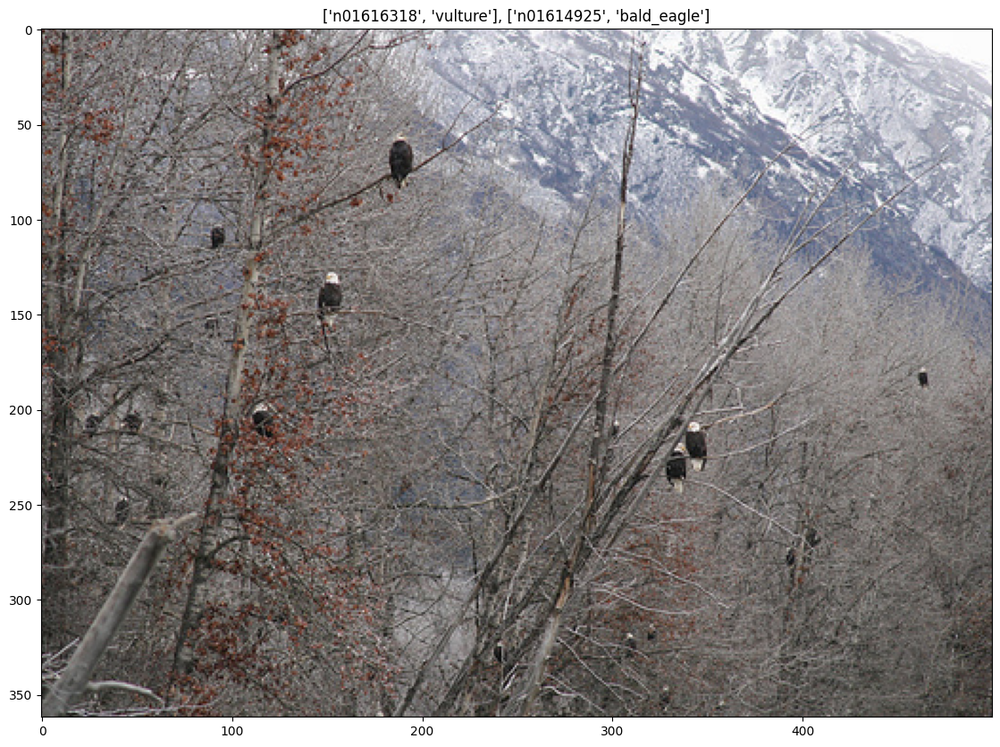

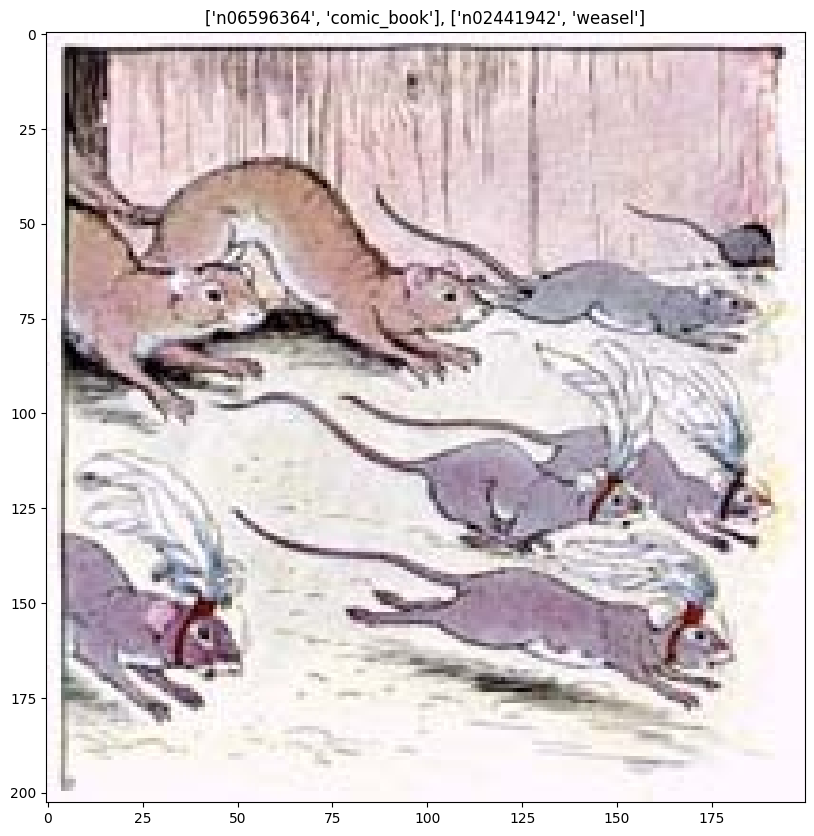

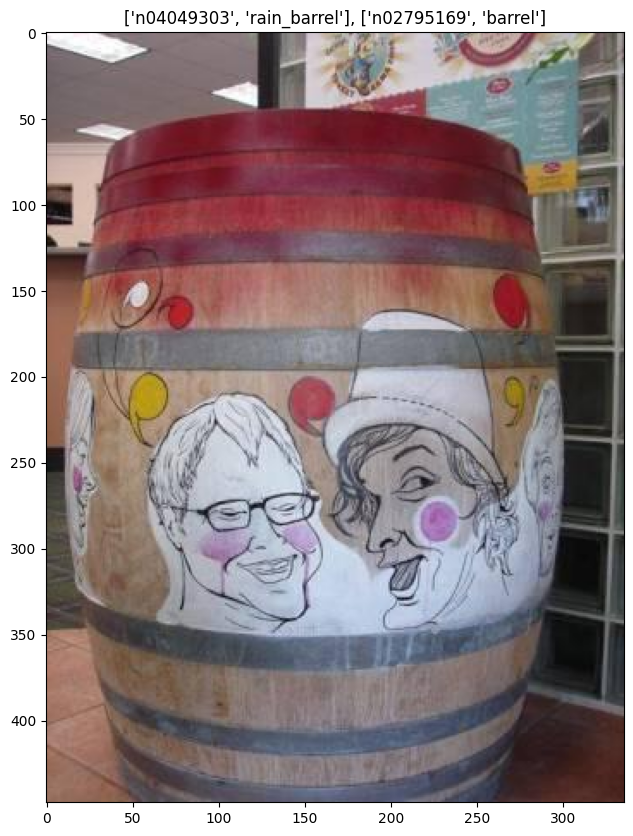

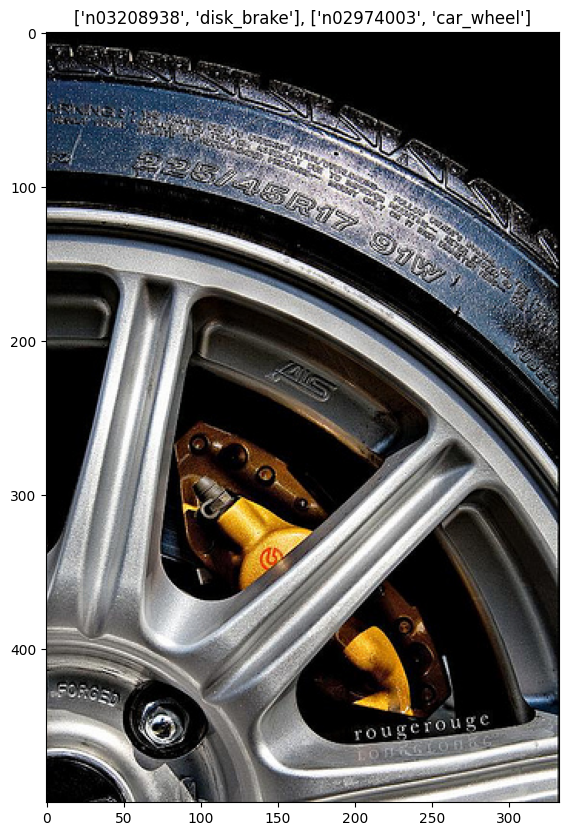

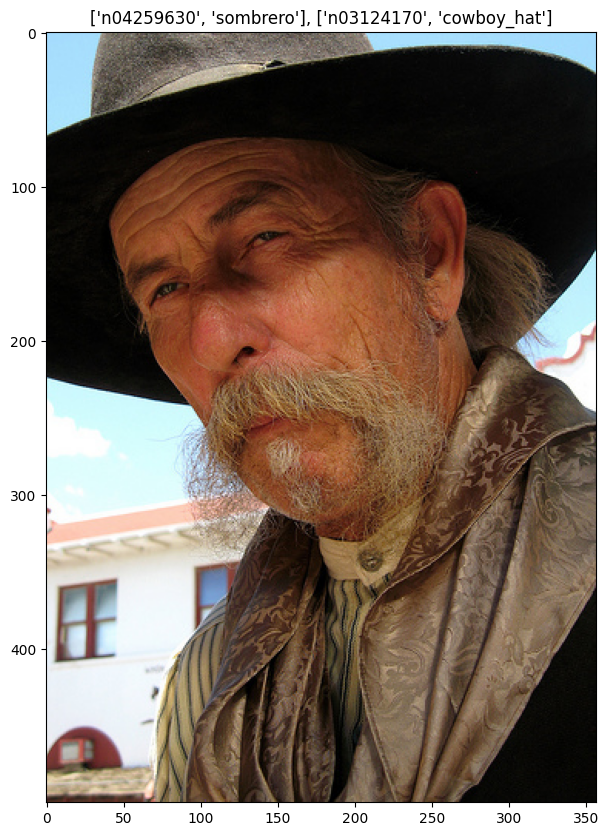

...

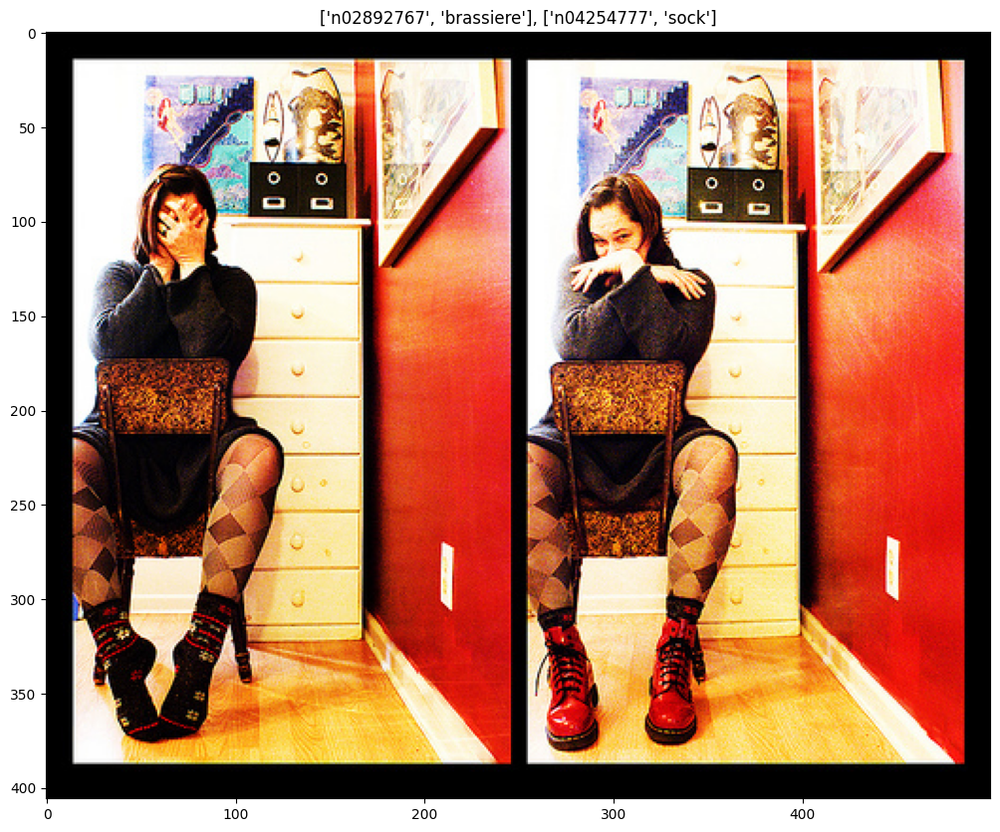

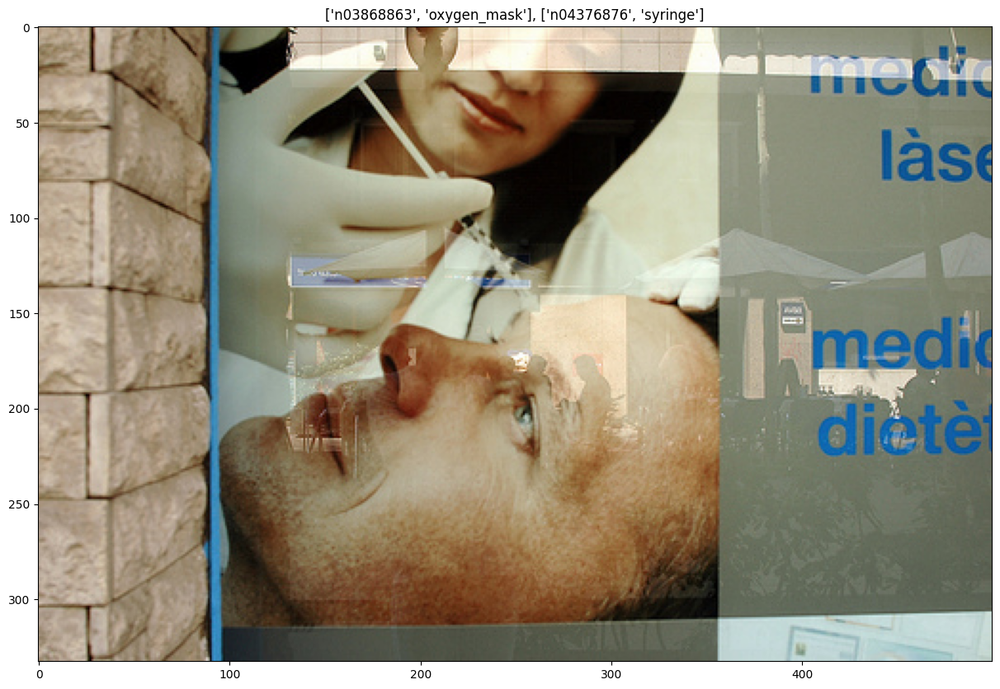

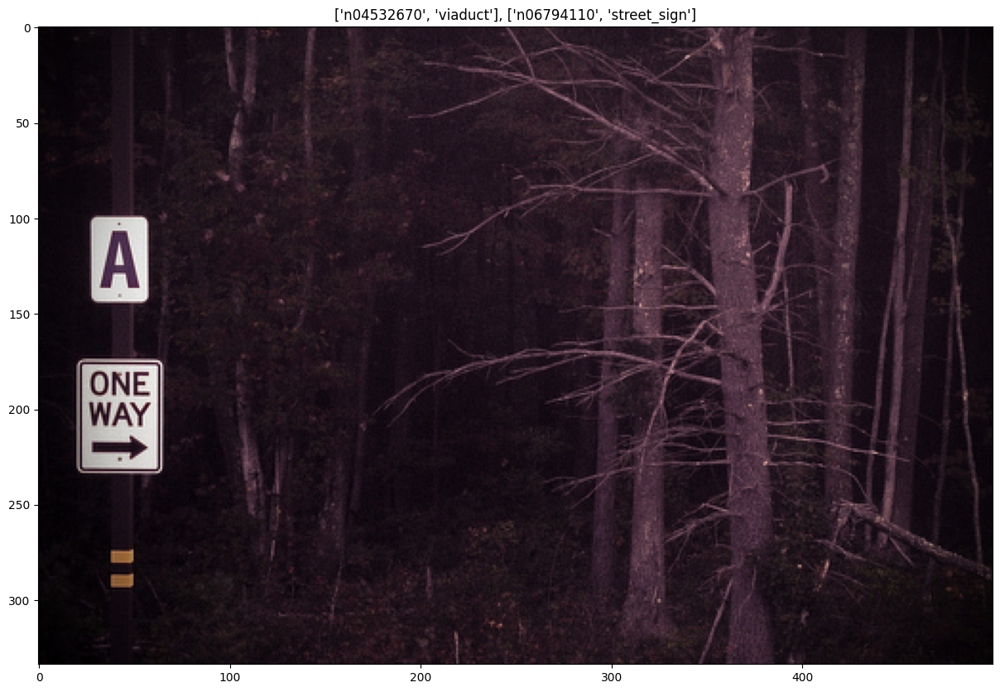

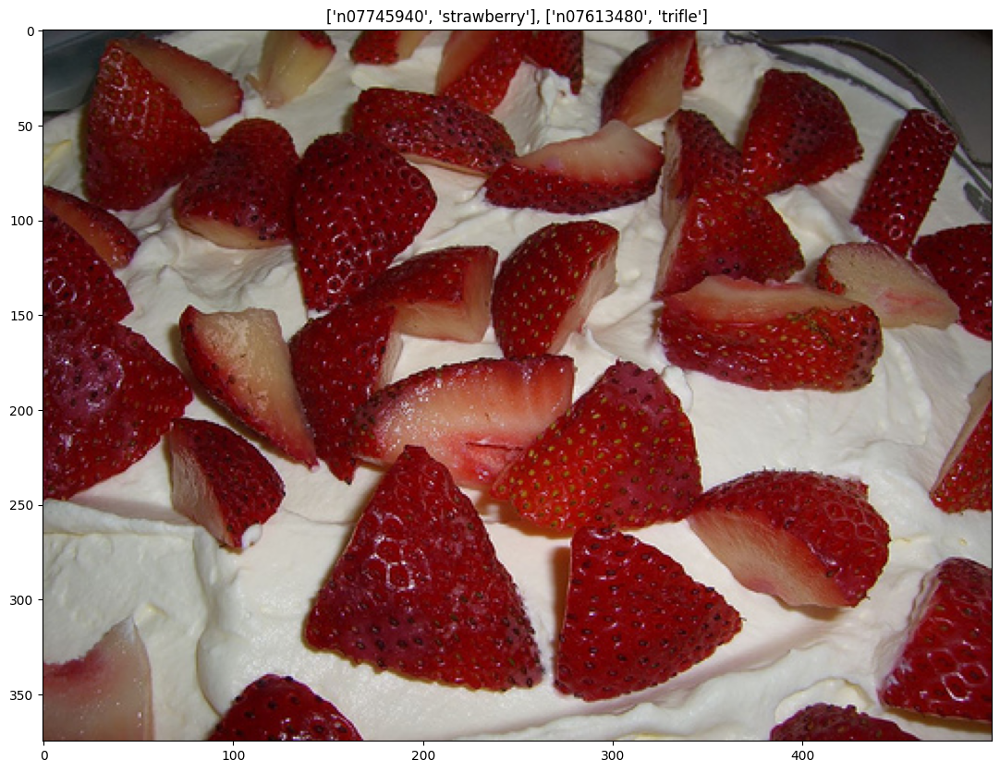

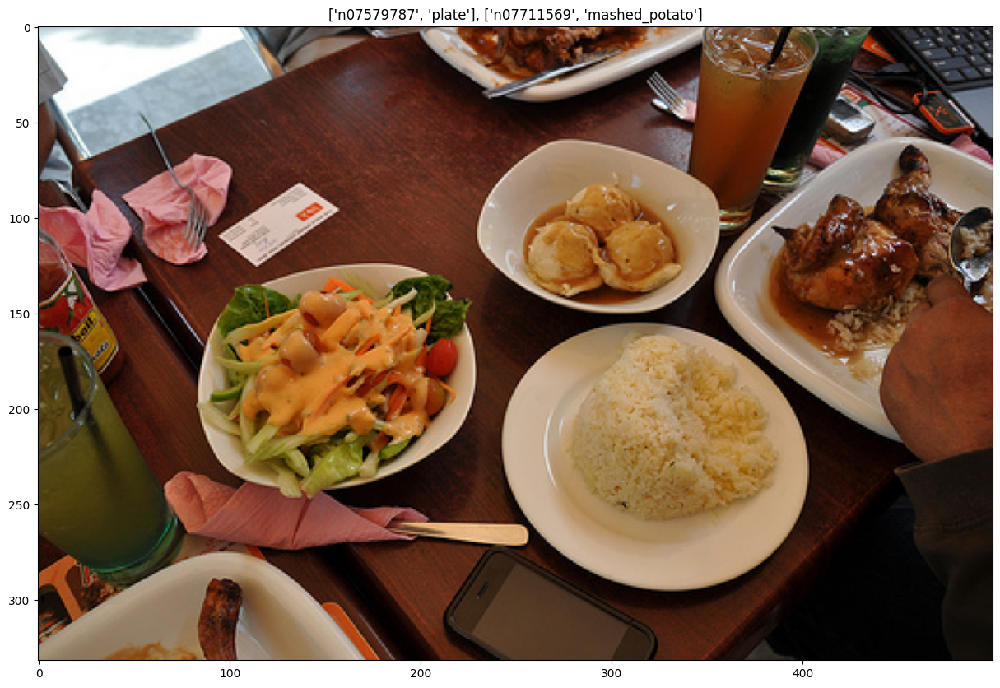

In [54]:
for idx in np.unique(oods)[::]:
    if np.abs(np.argmax(predictions[idx])-y[idx])>0:
        plt.figure()
        plt.imshow(Image.open(paths[idx]))
        plt.title(f"{idx_to_labels[str(int(np.argmax(predictions[idx])))]}, {idx_to_labels[str(int(y[idx]))]}")    

In [ ]:
from cdisco.vis import cdisco_concept_vis
dim_c = 2048
dim_w = 8
dim_h = 8
def cdisco_vis_extremes(concepts, candidates, conv_embeddings, conv_maps, paths, predictions, savefold=''):
    plt.rcParams['figure.figsize']=(20,10)
    mostleast={}
    oods=[]
    for c in concepts:
        p_data= np.dot(conv_embeddings, pvh[c,:].T)
        img_id=np.argmax((p_data))
        idx_pred=np.argmax(predictions[img_id])
        oods.append(img_id)
        
        plt.subplot(1,3,1)
        plt.imshow(Image.open(paths[np.argmax((p_data))]))
        plt.subplot(1,3,2)
    
        plt.imshow(Image.open(paths[np.argmax(p_data)]))
        concept_vector=pvh[c,:]
        img_id=np.argmax(p_data)
        idx_pred=np.argmax(predictions[img_id])
        fmap=cdisco_concept_vis(img_id, concept_vector, dim_c, dim_w, dim_h, conv_maps)

        plt.imshow((transform(Image.open(paths[img_id]))).swapaxes(0,1).swapaxes(1,-1))#,alpha=0.5)
        hmap=scipy.ndimage.zoom(fmap, 299/fmap.shape[0],order=1)
        plt.imshow(hmap, cmap='jet', alpha=0.8, vmin=-np.abs(hmap).max(), vmax=np.abs(hmap).max())

        plt.subplot(1,3,3)

        upsampled_fmap=scipy.ndimage.zoom(fmap, 299/fmap.shape[0],order=1)
        image=transform(Image.open(paths[img_id])).swapaxes(0,1).swapaxes(1,-1)

        th = np.percentile(upsampled_fmap,80) 
        mask=np.zeros((299,299,3))
        bmask=(upsampled_fmap>th)*1
        mask[:,:,0]=mask[:,:,1]=mask[:,:,2]=bmask
        image=transform(Image.open(paths[img_id])).swapaxes(0,1).swapaxes(1,-1)
        th_image=mask*image.cpu().numpy()
        plt.imshow(th_image)
        mostleast[c]=(np.argmin(p_data), np.argmax(p_data))
        plt.title(f"{c}, {idx_to_labels[str(idx_pred)]}")
        plt.axis("off")
        plt.savefig(f"outputs/conceptsoods_ml_{c}")
    return oods

oods = cdisco_vis_extremes(concepts, candidates, pembs, embs, paths, predictions, savefold='.')

In [ ]:
for img_id in np.unique(np.asarray(oods).ravel()):
    fmap=cdisco_concept_vis(img_id, concept_vector, dim_c, dim_w, dim_h, conv_maps)
    upsampled_fmap=scipy.ndimage.zoom(fmap, 299/fmap.shape[0],order=1)
    image=transform(Image.open(paths[img_id])).swapaxes(0,1).swapaxes(1,-1)

    th = np.percentile(upsampled_fmap,80) 
    mask=np.zeros((299,299,3))
    bmask=(upsampled_fmap>th)*1
    mask[:,:,0]=mask[:,:,1]=mask[:,:,2]=bmask
    image=transform(Image.open(paths[img_id])).swapaxes(0,1).swapaxes(1,-1)
    th_image=mask*image.cpu().numpy()
    plt.imshow(th_image)

In [ ]:
ccoods=[i for i in oods if i not in misclassified]

In [ ]:
plt.violinplot([eoeuncs[ccoods],eeuncs[ccoods], eoeuncs[misclassified], eeuncs[misclassified]])


In [ ]:
plt.hist(eeuncs[ridxs],density=True, alpha=0.5)#len(ridxs))
plt.hist(eeuncs[oods],density=True, alpha=0.5)#len(oods))
#plt.hist(eoeuncs[misclassified])

In [ ]:
plt.hist(epkl[ridxs],density=True, alpha=0.5)#len(ridxs))
plt.hist(epkl[oods],density=True, alpha=0.5)#len(oods))
#plt.hist(eoeuncs[misclassified])

In [ ]:
plt.hist(eeuncs[ridxs],density=True, alpha=0.5)#len(ridxs))
plt.hist(eeuncs[oods],density=True, alpha=0.5)#len(oods))
#plt.hist(eoeuncs[misclassified])

In [ ]:
ridxs=[i for i in np.arange(0,10000) if i not in oods]

In [ ]:
plt.violinplot([eoeuncs[oods],eeuncs[oods], eoeuncs[ridxs], eeuncs[ridxs]])

In [ ]:
plt.scatter(np.argmax(predictions[oods], axis=1), y[oods])

In [ ]:
plt.scatter(np.argmax(predictions[ridxs], axis=1), y[ridxs])

In [ ]:
import sklearn.metrics

sklearn.metrics.accuracy_score(y[oods], np.argmax(predictions[oods], axis=1)), sklearn.metrics.accuracy_score(y[ridxs], np.argmax(predictions[ridxs], axis=1))

In [ ]:
for idx in np.unique(oods):
    if np.abs(np.argmax(predictions[idx])-y[idx])>0:
        plt.figure()
        plt.imshow(Image.open(paths[idx]))
        plt.title(f"{idx_to_labels[str(int(np.argmax(predictions[idx])))]}, {idx_to_labels[str(int(y[idx]))]}")
        

In [ ]:
##### TEST DATA HERE

In [ ]:
paths

In [ ]:
model = torch.hub.load('pytorch/vision:v0.9.0', 'inception_v3', pretrained=True)
model.eval()
device=torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

layer='Mixed_7b.cat_2'
return_nodes={f'{layer}': 'conv', 'avgpool':'avgpool', 'fc':'fc'}
model_extr = torchvision.models.feature_extraction.create_feature_extractor(model, return_nodes=return_nodes)

In [ ]:
inputs=torch.zeros((8,3,299,299), dtype=torch.float).to(device)
model.to(device)
outs=model_extr(inputs)
dim_c = outs['conv'].shape[1]
dim_w = outs['conv'].shape[2]
dim_h = outs['conv'].shape[3]

In [ ]:
# I need to save the embeddings

conv_embeddings=np.zeros((len(y),dim_c, dim_w, dim_h))

batch_start=0
batch_size=32
m = torch.nn.Dropout(p=0.5)        
softmaxf = torch.nn.Softmax(dim=1)
p1=np.zeros((len(y),1000))
p2=np.zeros((len(y),1000))
p3=np.zeros((len(y),1000))
p4=np.zeros((len(y),1000))
p5=np.zeros((len(y),1000))
while batch_start+batch_size < len(y)+batch_size: 
        # preprocessing the inputs 
        inputs = torch.stack([transform_normalize(transform(Image.open(paths[i]).convert("RGB"))) for i in range(batch_start, min(batch_start+batch_size, len(y)))])
        inputs = inputs.clone().detach().requires_grad_(True)
        batch_y=y[batch_start:min(batch_start+batch_size, len(y))]

        # transfering to GPU
        inputs=inputs.to(device)
        outs = model_extr(inputs) 
        y1=model(m(inputs))
        y2=model(m(inputs))
        y3=model(m(inputs))
        y4=model(m(inputs))
        y5 = model(m(inputs))
        
        conv_embeddings[batch_start:min(batch_start+batch_size, len(y)),:,:,:]=outs['conv'].cpu().detach().numpy()
        p1[batch_start:min(batch_start+batch_size, len(y)),:]=softmaxf(y1).detach().cpu()
        p2[batch_start:min(batch_start+batch_size, len(y)),:]=softmaxf(y2).detach().cpu()
        p3[batch_start:min(batch_start+batch_size, len(y)),:]=softmaxf(y3).detach().cpu()
        p4[batch_start:min(batch_start+batch_size, len(y)),:]=softmaxf(y4).detach().cpu()
        p5[batch_start:min(batch_start+batch_size, len(y)),:]=softmaxf(y5).detach().cpu()
        batch_start+=batch_size

In [ ]:
#np.save('conv_embs_test.npy', conv_embeddings)
np.save('y1_test.npy', p1)#.cpu().detach().numpy())
np.save('y2_test.npy', p2)#.cpu().detach().numpy())
np.save('y3_test.npy', p3)#.cpu().detach().numpy())
np.save('y4_test.npy', p4)#.cpu().detach().numpy())
np.save('y5_test.npy', p5)#.cpu().detach().numpy())

In [ ]:
embs=conv_embeddings
pembs=np.mean(conv_embeddings,axis=(2,3))

In [ ]:
def outlier_detection(data):
    Q1,Q3 = np.percentile(data, [25,75])
    IQR = Q3 - Q1
    lower_range = Q1 - (1.5 * IQR)
    upper_range = Q3 + (1.5 * IQR)
    return lower_range, upper_range
def cdisco_vis_extremes(concepts, candidates, conv_embeddings, conv_maps, paths, predictions,savefold=''):
    plt.rcParams['figure.figsize']=(20,10)
    mostleast={}
    oods=[]
    for c in concepts:
        
        p_data= np.dot(conv_embeddings, pvh[c,:].T)
        lr,ur = outlier_detection(p_data)
        img_idx = np.argwhere(p_data>2*ur)
        img_idx2 = np.argwhere(p_data<2*lr)
        #import pdb; pdb.set_trace()
#         img_id=np.argmax(p_data)
#         idx_pred=np.argmax(predictions[img_id])
        #print(img_id, idx_pred, y[img_id])
        oods=oods+list(img_idx)+list(img_idx2)
        #oods.append(img_id)
    return oods

In [ ]:
oods=cdisco_vis_extremes(concepts, candidates, pembs, embs, paths, p1, savefold='.')

In [ ]:
oods

In [ ]:
oods = np.unique(np.asarray(oods).ravel())
for idx in np.unique(oods):
    if np.abs(np.argmax(p1[idx])-y[idx])>0:
        plt.figure()
        plt.imshow(Image.open(paths[idx]))
        plt.title(f"{idx_to_labels[str(int(np.argmax(p1[idx])))]}, {idx_to_labels[str(int(y[idx]))]}")
        
        

In [ ]:
from cdisco.vis import cdisco_concept_vis
def cdisco_vis_extremes(concepts, candidates, conv_embeddings, conv_maps, paths, predictions, savefold=''):
    plt.rcParams['figure.figsize']=(20,10)
    mostleast={}
    oods=[]
    for c in concepts:
        p_data= np.dot(conv_embeddings, pvh[c,:].T)
        img_id=np.argmax(np.abs(p_data))
        idx_pred=np.argmax(predictions[img_id])
        print(img_id, idx_pred, y[img_id])
        oods.append(img_id)
        p_data= np.dot(conv_embeddings, pvh[c,:].T)
        plt.figure()
        plt.subplot(1,4,1)
        plt.imshow(Image.open(paths[np.argmax(np.abs(p_data))]))
        plt.subplot(1,4,2)
        plt.imshow(Image.open(paths[np.argmax(np.abs(p_data))]))

        plt.subplot(1,4,3)
        #p_data= np.dot(conv_embeddings, pvh[34,:].T)
        plt.imshow(Image.open(paths[np.argmax(p_data)]))
        concept_vector=pvh[c,:]
        img_id=np.argmax(p_data)
        idx_pred=np.argmax(predictions[img_id])
        fmap=cdisco_concept_vis(img_id, concept_vector, dim_c, dim_w, dim_h, conv_maps)

        plt.imshow((transform(Image.open(paths[img_id]))).swapaxes(0,1).swapaxes(1,-1))#,alpha=0.5)
        hmap=scipy.ndimage.zoom(fmap, 299/fmap.shape[0],order=1)
        plt.imshow(hmap, cmap='jet', alpha=0.8, vmin=-np.abs(hmap).max(), vmax=np.abs(hmap).max())

        plt.subplot(1,4,4)

        upsampled_fmap=scipy.ndimage.zoom(fmap, 299/fmap.shape[0],order=1)
        image=transform(Image.open(paths[img_id])).swapaxes(0,1).swapaxes(1,-1)

        th = np.percentile(upsampled_fmap,80) 
        mask=np.zeros((299,299,3))
        bmask=(upsampled_fmap>th)*1
        mask[:,:,0]=mask[:,:,1]=mask[:,:,2]=bmask
        image=transform(Image.open(paths[img_id])).swapaxes(0,1).swapaxes(1,-1)
        th_image=mask*image.cpu().numpy()
        #plt.imshow(th_image)
        #patch=image[max(0,xm-20):min(299,xm+20),max(ym-20,0):min(ym+20,299)]
        plt.imshow(th_image)
        mostleast[c]=(np.argmin(p_data), np.argmax(p_data))
        plt.title(f"{c}, {idx_to_labels[str(idx_pred)]}")
        plt.axis("off")
        plt.savefig(f"outputs/quickie_conceptsoods_ml_{c}")
    return oods
oods = cdisco_vis_extremes(concepts, candidates, pembs, embs, paths, p1, savefold='.')

In [ ]:
for idx in np.unique(oods):
    if np.abs(np.argmax(p1[idx])-y[idx])>0:
        plt.figure()
        plt.imshow(Image.open(paths[idx]))
        plt.title(f"{idx_to_labels[str(int(np.argmax(p1[idx])))]}, {idx_to_labels[str(int(y[idx]))]}")
        

In [ ]:
sklearn.metrics.accuracy_score(np.argmax(p1[oods[:6]], axis=1),y[oods[:6]])

In [ ]:
all_preds = np.asarray([p1,p2,p3,p4,p5])
uncs=[] #expected entropy
eoeuncs=[] #entropy of expected
epsilon=1e-10

mean_probs = np.mean(all_preds, axis=0)
log_probs = -np.log(mean_probs + epsilon)
eeuncs=np.mean((np.sum(all_preds * log_probs, axis=-1)),axis=0)
eoeuncs=np.sum(mean_probs * log_probs, axis=-1)

In [ ]:
ridxs=[i for i in np.arange(0,1000) if i not in oods]

In [ ]:
oods

In [ ]:
plt.hist(eeuncs[ridxs],density=True, alpha=0.5)#len(ridxs))
plt.hist(eeuncs[oods[:5]],density=True, alpha=0.5)#len(oods))
#plt.hist(eoeuncs[misclassified])

In [ ]:
mean_probs = np.mean(all_preds, axis=0)
mean_lprobs = np.mean(np.log(all_preds + epsilon), axis=0)
#conf = np.max(mean_probs, axis=-1)

#eoe = entropy_of_expected(probs, epsilon)
#exe = expected_entropy(probs, epsilon)

mutual_info = eoeuncs - eeuncs

epkl = -np.sum(mean_probs * mean_lprobs, axis=-1) - eeuncs

In [ ]:
plt.hist(epkl[ridxs],density=True, alpha=0.5)#len(ridxs))
plt.hist(epkl[oods],density=True, alpha=0.5)#len(oods))
#plt.hist(eoeuncs[misclassified])

In [ ]:
plt.hist(mutual_info[ridxs],density=True, alpha=0.5)#len(ridxs))
plt.hist(mutual_info[oods],density=True, alpha=0.5)#len(oods))
#plt.hist(eoeuncs[misclassified])

In [ ]:
import torchvision
import ctypes
import torchvision
import pandas
import os
import matplotlib.pyplot as plt
import PIL.Image as Image
import numpy as np
import torchvision
import torch
import json
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

transform = torchvision.transforms.Compose([
 torchvision.transforms.Resize(299),
 torchvision.transforms.CenterCrop(299),
 torchvision.transforms.ToTensor()
])

transform_normalize = torchvision.transforms.Normalize(
     mean=[0.485, 0.456, 0.406],
     std=[0.229, 0.224, 0.225]
 )

def get_label(idx_to_labels,id_):
    for k in list(idx_to_labels.keys()):
        if id_ in idx_to_labels[k]:
            return k

def get_ilsvrc_dir(path):
    return path.split('/')[-2]
    
def get_dataset(dname, source=None, train=True):
    dataset=dname
    count=0
    if dname=='ilsvrc12':
        if source==None:
            source = f'/mnt/nas4/datasets/ToReadme/{dataset}/'
        if train:
            source = (source+'train')
        else:
            source = (source+'val')
            
        labels_path = os.getenv("HOME") + '/.torch/models/imagenet_class_index.json'
        lim=10

    elif dname=='imagenette':
        if not source:
            source = f'./{dataset}2-320/'
            train_files_path=(source+'train')
        labels_path = os.getenv("HOME") + '/.torch/models/imagenet_class_index.json'
        lim=500
            
    elif dname=='imagewoof':
        if not source:
            source = f'./{dataset}2-320/'
            train_files_path=(source+'train')
        labels_path = os.getenv("HOME") + '/.torch/models/imagenet_class_index.json'
        lim=500
    
    with open(labels_path) as json_data:
        idx_to_labels = json.load(json_data)
            
    if train:
        paths=[]
        labels = {}
        k=0
        image_counter=0
        for dir_ in os.listdir(source):#+'/train'):
            count+= len(os.listdir(source+'/'+dir_))
            labels[dir_]=get_label(idx_to_labels, dir_)
            k+=1
            image_counter=0
            for p in os.listdir(source+'/'+dir_):
                if image_counter < lim:
                    paths.append(source+'/'+dir_+'/'+p)
                    image_counter+=1

        count = int(len(paths))

        y=np.zeros(count)

        for i in range(count):   
                dir_ = get_ilsvrc_dir(paths[i])
                y[i] = labels[dir_]
    else:
        lim=1000
        paths=[]
        labels = {}
        k=0
        image_counter=0
        for dir_ in os.listdir(source)[::10]:#+'/train'):
            count+= 1 #len(os.listdir(source+'/'+dir_))
            labels[dir_]=1. #get_label(idx_to_labels, dir_)
            k+=1
            #image_counter+=1
            #for p in os.listdir(source+'/'+dir_):
            if image_counter < lim:
                paths.append(source+'/'+dir_)
                image_counter+=1
        
        count = int(len(paths))
        y=np.zeros(count)
        labelsfile=open('/mnt/nas4/datasets/ToReadme/ilsvrc12/val.txt','r').readlines()
        #import pdb; pdb.set_trace()
        labs={}
        for lentry in labelsfile:
            key,lab = lentry.split(' ')[0],lentry.split(' ')[1]
            labs[key]=int(lab.strip('\n'))
        for i in range(count):   
                dir_ = paths[i][41:]
                y[i] = labs[dir_] # 1. #labels[dir_]

    return paths, count, y, idx_to_labels, labs

                            
# import sys
# sys.path.append('./scripts/')
# import imp

# from datasets import *
#imp.reload(datasets)
#from datasets import *
import scipy.ndimage
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"   # see issue #152
os.environ["CUDA_VISIBLE_DEVICES"]="1"

dataset='ilsvrc12'
paths, count, y, idx_to_labels, labs = get_dataset(dataset, train=False)

print(count, len(paths))

In [ ]:
paths